In [3]:
import numpy as np 
import pandas as pd
import os
from pathlib import Path
from sklearn.model_selection import train_test_split

In [4]:
from keras.preprocessing.image import ImageDataGenerator
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, Conv2DTranspose,BatchNormalization,LeakyReLU,Reshape
#from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import legacy
#from tensorflow.keras.losses import SparseCategoricalCrossentropy
from keras.callbacks import EarlyStopping
from keras.callbacks import LearningRateScheduler
import math
import tensorflow as tf

In [281]:
#pip install imageio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 313.4/313.4 kB 3.4 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [313]:
#pip install pydot

Note: you may need to restart the kernel to use updated packages.


In [282]:
#to generate gif's
#import imageio

In [5]:
direc = Path('/Users/vedant/Documents/George Mason/Data Analytics material/AIT 736 AML/Project/zap50k/ut-zap50k-images-square/ut-zap50k-images-square')
filepaths = list(direc.glob(r'**/**/**/*.jpg'))
Labels = list(map(lambda x: os.path.split(os.path.split(x)[0])[1],filepaths))


filepaths = pd.Series(filepaths, name='FilePaths').astype(str)
Labels = pd.Series(Labels, name='Labels').astype(str)

img_df = pd.merge(filepaths, Labels, right_index = True, left_index = True)

img_df.head(10)

,FilePaths,Labels
0,/Users/vedant/Documents/George Mason/Data Anal...,Kid Express
1,/Users/vedant/Documents/George Mason/Data Anal...,Timberland Kids
2,/Users/vedant/Documents/George Mason/Data Anal...,Hunter
3,/Users/vedant/Documents/George Mason/Data Anal...,Hunter
4,/Users/vedant/Documents/George Mason/Data Anal...,Hunter
5,/Users/vedant/Documents/George Mason/Data Anal...,Hunter
6,/Users/vedant/Documents/George Mason/Data Anal...,Hunter
7,/Users/vedant/Documents/George Mason/Data Anal...,Hunter
8,/Users/vedant/Documents/George Mason/Data Anal...,Hunter
9,/Users/vedant/Documents/George Mason/Data Anal...,Hunter


In [6]:
fp = filepaths.str.split(pat="/", n = 14, expand = True)

Label1 = fp[11]+" - "+fp[12]
Label1 = pd.DataFrame(Label1)
Label1 = Label1.rename(columns = {0:'Label1'})

img_df2 = pd.concat([img_df, Label1], axis=1)
img_df2 = img_df2.drop('Labels', axis=1)
img_df2

,FilePaths,Label1
0,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Prewalker Boots
1,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Prewalker Boots
2,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Mid-Calf
3,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Mid-Calf
4,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Mid-Calf
...,...,...
50061,/Users/vedant/Documents/George Mason/Data Anal...,Shoes - Crib Shoes
50062,/Users/vedant/Documents/George Mason/Data Anal...,Shoes - Crib Shoes
50063,/Users/vedant/Documents/George Mason/Data Anal...,Shoes - Crib Shoes
50064,/Users/vedant/Documents/George Mason/Data Anal...,Shoes - Crib Shoes


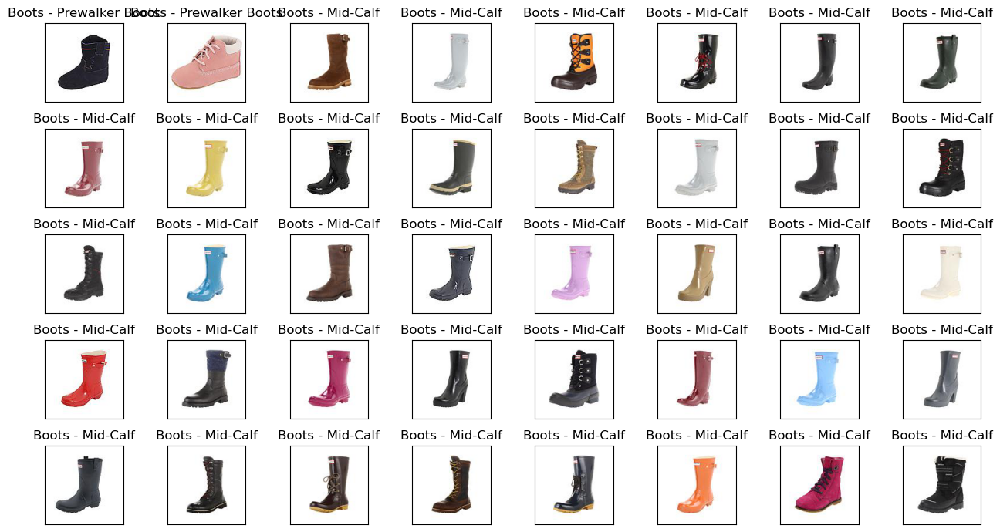

In [7]:
import matplotlib.pyplot as plt
f,a = plt.subplots(nrows=5, ncols=8,figsize=(13, 7),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(a.flat):
    ax.imshow(plt.imread(img_df2.FilePaths[i]))
    ax.set_title(img_df2.Label1[i])
    
plt.tight_layout()
plt.show()

In [8]:
img_df2['Label1'].value_counts(ascending=True)

Label1
Boots - Prewalker Boots                    2
Slippers - Slipper Heels                  10
Slippers - Boot                           14
Sandals - Athletic                        14
Shoes - Crib Shoes                        23
Boots - Over the Knee                     49
Sandals - Heel                           126
Shoes - Prewalker                        249
Shoes - Firstwalker                      369
Shoes - Boat Shoes                       629
Slippers - Slipper Flats                1259
Shoes - Clogs and Mules                 1427
Shoes - Oxfords                         2044
Boots - Knee High                       2202
Shoes - Loafers                         2875
Shoes - Flats                           3994
Boots - Mid-Calf                        4726
Sandals - Flat                          5601
Shoes - Heels                           5739
Boots - Ankle                           5855
Shoes - Sneakers and Athletic Shoes    12859
Name: count, dtype: int64

**Removing Rows < 100 labels**

In [9]:
# Threshold for minimum number of images per class
threshold = 100

# Filter out labels with fewer than threshold images
labels_to_remove = img_df2['Label1'].value_counts()[img_df2['Label1'].value_counts() < threshold].index

# Remove rows with labels to be removed
filtered_img_df = img_df2[~img_df2['Label1'].isin(labels_to_remove)]

# Display the filtered DataFrame
print(filtered_img_df.head())

                                           FilePaths            Label1
2  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf
3  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf
4  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf
5  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf
6  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf


In [10]:
filtered_img_df['Label1'].value_counts(ascending=True)

Label1
Sandals - Heel                           126
Shoes - Prewalker                        249
Shoes - Firstwalker                      369
Shoes - Boat Shoes                       629
Slippers - Slipper Flats                1259
Shoes - Clogs and Mules                 1427
Shoes - Oxfords                         2044
Boots - Knee High                       2202
Shoes - Loafers                         2875
Shoes - Flats                           3994
Boots - Mid-Calf                        4726
Sandals - Flat                          5601
Shoes - Heels                           5739
Boots - Ankle                           5855
Shoes - Sneakers and Athletic Shoes    12859
Name: count, dtype: int64

In [11]:
print(filtered_img_df)

                                               FilePaths            Label1
2      /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf
3      /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf
4      /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf
5      /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf
6      /Users/vedant/Documents/George Mason/Data Anal...  Boots - Mid-Calf
...                                                  ...               ...
50038  /Users/vedant/Documents/George Mason/Data Anal...     Shoes - Flats
50039  /Users/vedant/Documents/George Mason/Data Anal...     Shoes - Flats
50040  /Users/vedant/Documents/George Mason/Data Anal...     Shoes - Flats
50041  /Users/vedant/Documents/George Mason/Data Anal...     Shoes - Flats
50042  /Users/vedant/Documents/George Mason/Data Anal...     Shoes - Flats

[49954 rows x 2 columns]


**Train-Test Split**

In [10]:
train_ratio = 0.70
validation_ratio = 0.15
test_ratio = 0.15


X_train, X_test = train_test_split(filtered_img_df, test_size=1 - train_ratio, stratify=filtered_img_df['Label1'])
X_val, X_test = train_test_split(X_test, test_size=test_ratio/(test_ratio + validation_ratio),stratify=X_test['Label1']) 

print(f'Shape of Training Data : ',X_train.shape)
print(f'Shape of Testing Data : ',X_test.shape)
print(f'Shape of Validation Data : ',X_val.shape)
X_test = X_test.copy()

Shape of Training Data :  (34967, 2)
Shape of Testing Data :  (7494, 2)
Shape of Validation Data :  (7493, 2)


**DaTA Augmentation**

In [11]:
img_datagen = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.mobilenet_v2.preprocess_input,
    rescale=1./255  # Rescale pixel values to [0, 1]
)

In [18]:
img_size=(224, 224)   

In [13]:
X_train = img_datagen.flow_from_dataframe(
    dataframe=X_train,
    x_col='FilePaths',
    y_col='Label1',
    target_size=img_size,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,
    seed=60
)

# For validation and test sets, we don't apply augmentation
X_val = img_datagen.flow_from_dataframe(
    dataframe=X_val,
    x_col='FilePaths',
    y_col='Label1',
    target_size=img_size,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,
    seed=60,
    shuffle=False  # Don't shuffle validation data
)

X_test = img_datagen.flow_from_dataframe(
    dataframe=X_test,
    x_col='FilePaths',
    y_col='Label1',
    target_size=img_size,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=32,
    seed=60,
    shuffle=False  # Don't shuffle test data
)

Found 34967 validated image filenames belonging to 15 classes.
Found 7493 validated image filenames belonging to 15 classes.
Found 7494 validated image filenames belonging to 15 classes.


**Building the CNN model**

In [329]:
def cnn_model(input_shape, num_classes):
    model = Sequential([
        # Convolutional layers
        Conv2D(64, (3, 3), activation='relu', input_shape=input_shape),
        MaxPooling2D((2, 2)),
        Conv2D(128, (3, 3), activation='relu'),
        MaxPooling2D((2, 2)),
        Conv2D(64, (3, 3), activation='relu'),
        MaxPooling2D((2, 2)),
        
        
        # Flatten the feature maps
        Flatten(),
        
        # Fully connected layers
        Dense(700, activation='relu'),
        Dropout(0.25),
        #Dense(units = 256,activation = 'relu'),
        #Dropout(0.5),
        #Dense(units = 256,activation = 'relu'),
        #Dropout(0.25),
        #Dense(units = 128,activation = 'relu'),
        #Dropout(0.10),
        Dense(num_classes, activation='softmax')  # Output layer with softmax activation
    ])
    return model
    

In [29]:
input_shape = (224, 224, 3) 
num_classes = 15

In [331]:
cnn_model = cnn_model(input_shape, num_classes)

In [332]:
early_stopping = EarlyStopping(monitor='val_loss', patience=3)

In [333]:
def lr_schedule(epoch):
    lr = 0.0001 * math.pow(0.5, math.floor((1+epoch)/10))
    return lr

In [12]:
optimizer = legacy.Adam(learning_rate=0.0001)

In [335]:

# Define a learning rate scheduler callback
lr_scheduler = LearningRateScheduler(lr_schedule)

# Compile the model
cnn_model.compile(optimizer= optimizer,
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])

# Print model summary
cnn_model.summary()

Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_97 (Conv2D)          (None, 222, 222, 64)      1792      
                                                                 
 max_pooling2d_57 (MaxPooli  (None, 111, 111, 64)      0         
 ng2D)                                                           
                                                                 
 conv2d_98 (Conv2D)          (None, 109, 109, 128)     73856     
                                                                 
 max_pooling2d_58 (MaxPooli  (None, 54, 54, 128)       0         
 ng2D)                                                           
                                                                 
 conv2d_99 (Conv2D)          (None, 52, 52, 64)        73792     
                                                                 
 max_pooling2d_59 (MaxPooli  (None, 26, 26, 64)      

**Training the model**

In [336]:


history = cnn_model.fit(X_train,
                        epochs=10,  
                        batch_size=2400,  
                        validation_data=X_val,
                        callbacks=[early_stopping])




Epoch 1/10


2024-04-08 21:09:06.312242: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1093/1093 [==============================] - ETA: 0s - loss: 1.2165 - accuracy: 0.6129

2024-04-08 21:11:16.285709: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1093/1093 [==============================] - 137s 125ms/step - loss: 1.2165 - accuracy: 0.6129 - val_loss: 0.9349 - val_accuracy: 0.6944
Epoch 2/10
1093/1093 [==============================] - 134s 123ms/step - loss: 0.9456 - accuracy: 0.6997 - val_loss: 0.8424 - val_accuracy: 0.7376
Epoch 3/10
1093/1093 [==============================] - 134s 122ms/step - loss: 0.8629 - accuracy: 0.7323 - val_loss: 0.8204 - val_accuracy: 0.7552
Epoch 4/10
1093/1093 [==============================] - 134s 123ms/step - loss: 0.8848 - accuracy: 0.7441 - val_loss: 0.7977 - val_accuracy: 0.7811
Epoch 5/10
1093/1093 [==============================] - 135s 123ms/step - loss: 1.1219 - accuracy: 0.7428 - val_loss: 1.2005 - val_accuracy: 0.7654
Epoch 6/10
1093/1093 [==============================] - 132s 121ms/step - loss: 1.9413 - accuracy: 0.7343 - val_loss: 2.7503 - val_accuracy: 0.7451
Epoch 7/10
1093/1093 [==============================] - 132s 121ms/step - loss: 4.1534 - accuracy: 0.7316 - val_loss: 5.389

In [327]:
# Evaluate the model on test data
test_loss, test_accuracy = cnn_model.evaluate(X_test)

print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

235/235 [==============================] - 7s 30ms/step - loss: 722.2329 - accuracy: 0.7345
Test Loss: 722.23291015625
Test Accuracy: 0.7344542145729065


## Generative Adversarial Network ##

### Deep Convolution Generative Adversarial Network(DCGAN)

**Data Augmentation: Rescaling Images in the range of [-1, 1] and removing labels for feeding to GAN's**

In [262]:
filtered_img_df

,FilePaths,Label1
2,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Mid-Calf
3,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Mid-Calf
4,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Mid-Calf
5,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Mid-Calf
6,/Users/vedant/Documents/George Mason/Data Anal...,Boots - Mid-Calf
...,...,...
50036,/Users/vedant/Documents/George Mason/Data Anal...,Shoes - Flats
50037,/Users/vedant/Documents/George Mason/Data Anal...,Shoes - Flats
50038,/Users/vedant/Documents/George Mason/Data Anal...,Shoes - Flats
50039,/Users/vedant/Documents/George Mason/Data Anal...,Shoes - Flats


In [261]:
filtered_img_df = filtered_img_df[:-2]

In [13]:
sneakers_df = filtered_img_df[filtered_img_df['Label1'] == 'Shoes - Sneakers and Athletic Shoes']

In [16]:
print(sneakers_df)

                                               FilePaths  \
25038  /Users/vedant/Documents/George Mason/Data Anal...   
25039  /Users/vedant/Documents/George Mason/Data Anal...   
25040  /Users/vedant/Documents/George Mason/Data Anal...   
25041  /Users/vedant/Documents/George Mason/Data Anal...   
25042  /Users/vedant/Documents/George Mason/Data Anal...   
...                                                  ...   
37833  /Users/vedant/Documents/George Mason/Data Anal...   
37834  /Users/vedant/Documents/George Mason/Data Anal...   
37835  /Users/vedant/Documents/George Mason/Data Anal...   
37836  /Users/vedant/Documents/George Mason/Data Anal...   
37837  /Users/vedant/Documents/George Mason/Data Anal...   

                                    Label1  
25038  Shoes - Sneakers and Athletic Shoes  
25039  Shoes - Sneakers and Athletic Shoes  
25040  Shoes - Sneakers and Athletic Shoes  
25041  Shoes - Sneakers and Athletic Shoes  
25042  Shoes - Sneakers and Athletic Shoes  
...      

In [15]:
sneakers_df = sneakers_df[:-59]

In [98]:
sandals_df = filtered_img_df[filtered_img_df['Label1'] == 'Sandals - Flat']

In [99]:
sandals_df = sandals_df[:-1]

In [100]:
print(sandals_df)

                                               FilePaths          Label1
12834  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat
12835  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat
12836  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat
12837  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat
12838  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat
...                                                  ...             ...
18429  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat
18430  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat
18431  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat
18432  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat
18433  /Users/vedant/Documents/George Mason/Data Anal...  Sandals - Flat

[5600 rows x 2 columns]


In [73]:
label_categories = ['Boots - Ankle', 'Boots - Mid-Calf', 'Boots - Knee High']

# Filter the original dataframe to include only the specified label categories
boots_df = filtered_img_df[filtered_img_df['Label1'].isin(label_categories)]


In [75]:
boots_df = boots_df[:-15]

In [76]:
print(boots_df)

                                               FilePaths             Label1
2      /Users/vedant/Documents/George Mason/Data Anal...   Boots - Mid-Calf
3      /Users/vedant/Documents/George Mason/Data Anal...   Boots - Mid-Calf
4      /Users/vedant/Documents/George Mason/Data Anal...   Boots - Mid-Calf
5      /Users/vedant/Documents/George Mason/Data Anal...   Boots - Mid-Calf
6      /Users/vedant/Documents/George Mason/Data Anal...   Boots - Mid-Calf
...                                                  ...                ...
12814  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Knee High
12815  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Knee High
12816  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Knee High
12817  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Knee High
12818  /Users/vedant/Documents/George Mason/Data Anal...  Boots - Knee High

[12768 rows x 2 columns]


In [101]:
# Custom preprocessing function to rescale pixel values to [-1, 1]
def preprocess_image(image):
    image = tf.image.resize(image, img_size) # Resize the image to img_size
    image = (image / 127.5) - 1  # Rescale pixel values to [-1, 1]
    return image

# Create an ImageDataGenerator with preprocessing_function
img_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_image
)

# Flow images from the DataFrame in batches
TrainSample_gan = img_datagen.flow_from_dataframe(
    dataframe=filtered_img_df,
    x_col='FilePaths',
    target_size=img_size,
    color_mode='rgb',
    batch_size=32,
    class_mode=None,  # No labels needed
    shuffle=True  # Shuffle the data
)

Found 5600 validated image filenames.


In [78]:
# Get the shape of image_generator
print("Shape of image_generator:", TrainSample_gan.image_shape)

# Display the dimensions of a few images from the generator
for i in range(3):  # Display dimensions of the first 3 images
    batch = next(TrainSample_gan)
    print("Dimensions of image", i+1, ":", batch.shape)

Shape of image_generator: (224, 224, 3)
Dimensions of image 1 : (32, 224, 224, 3)
Dimensions of image 2 : (32, 224, 224, 3)
Dimensions of image 3 : (32, 224, 224, 3)


In [79]:
for i in range(3):
    batch = next(TrainSample_gan)
    
    # Check pixel values of images in the batch
    for image in batch:
        # Check if any pixel value is outside the range [-1, 1]
        if np.any(image > 1) or np.any(image < -1):
            print("Image pixel values are not within the range [-1, 1]")
            break
    else:
        print("All pixel values are within the range [-1, 1] in batch", i+1)

All pixel values are within the range [-1, 1] in batch 1
All pixel values are within the range [-1, 1] in batch 2
All pixel values are within the range [-1, 1] in batch 3


**Define Generator**

In [80]:
latent_dim = 100

In [102]:
def build_generator(latent_dim):
    model = Sequential()
    model.add(Dense(7 * 7 * 128, input_dim=latent_dim))
    model.add(Reshape((7, 7, 128)))
    
    model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization())
    
    model.add(Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization())

    model.add(Conv2DTranspose(32, (4, 4), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization())

    model.add(Conv2DTranspose(16, (4, 4), strides=(2, 2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization())

    model.add(Conv2DTranspose(3, (4, 4), strides=(2, 2), padding='same', activation='tanh'))
    return model

In [103]:
generator = build_generator(latent_dim)

In [104]:
generator.summary()

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 6272)              633472    
                                                                 
 reshape_6 (Reshape)         (None, 7, 7, 128)         0         
                                                                 
 conv2d_transpose_30 (Conv2  (None, 14, 14, 128)       262272    
 DTranspose)                                                     
                                                                 
 leaky_re_lu_43 (LeakyReLU)  (None, 14, 14, 128)       0         
                                                                 
 batch_normalization_24 (Ba  (None, 14, 14, 128)       512       
 tchNormalization)                                               
                                                                 
 conv2d_transpose_31 (Conv2  (None, 28, 28, 64)      

(-0.5, 223.5, 223.5, -0.5)

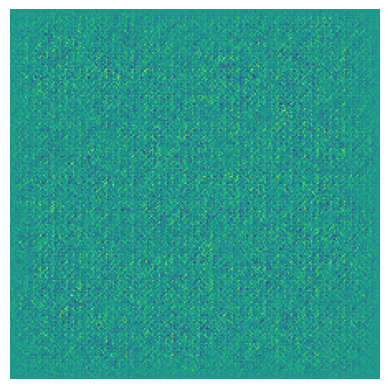

In [105]:
#Creating a random seed and output from generator
seed = tf.random.normal([1, latent_dim])
Generated_Portrait = generator(seed, training=False)
#Plotting the image output of generator without training 
plt.imshow(Generated_Portrait[0, :, :, 0])
plt.axis("off")

**Define Discriminator**

In [106]:
def build_discriminator(input_shape):
    model = Sequential()
    model.add(Conv2D(64, kernel_size=3, strides=2, input_shape=input_shape, padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Conv2D(128, kernel_size=3, strides=2, padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Conv2D(256, kernel_size=3, strides=2, padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))
    return model


In [107]:
discriminator = build_discriminator(input_shape)

In [108]:
discriminator.summary()

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_19 (Conv2D)          (None, 112, 112, 64)      1792      
                                                                 
 leaky_re_lu_47 (LeakyReLU)  (None, 112, 112, 64)      0         
                                                                 
 conv2d_20 (Conv2D)          (None, 56, 56, 128)       73856     
                                                                 
 leaky_re_lu_48 (LeakyReLU)  (None, 56, 56, 128)       0         
                                                                 
 conv2d_21 (Conv2D)          (None, 28, 28, 256)       295168    
                                                                 
 leaky_re_lu_49 (LeakyReLU)  (None, 28, 28, 256)       0         
                                                                 
 flatten_6 (Flatten)         (None, 200704)          

In [109]:
#for the random image generated
Discriminator_Verdict = discriminator(Generated_Portrait)
print (Discriminator_Verdict)

tf.Tensor([[0.50010055]], shape=(1, 1), dtype=float32)


**Define GAN function*

In [110]:
# Define the GAN model
def build_gan(generator, discriminator):
    discriminator.trainable = False
    model = Sequential()
    model.add(generator)
    model.add(discriminator)
    return model


In [111]:
# Build and compile the discriminator
discriminator = build_discriminator(input_shape)
discriminator.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])


In [112]:
# Build and compile the generator
generator = build_generator(latent_dim)
generator.compile(loss='binary_crossentropy', optimizer=optimizer)


In [113]:
# Build and compile the GAN model
gan = build_gan(generator, discriminator)
gan.compile(loss='binary_crossentropy', optimizer=optimizer)


In [114]:
gan.layers

In [115]:
gan.summary()

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_19 (Sequential)  (None, 224, 224, 3)       1069619   
                                                                 
 sequential_18 (Sequential)  (None, 1)                 571521    
                                                                 
Total params: 1641140 (6.26 MB)
Trainable params: 1069139 (4.08 MB)
Non-trainable params: 572001 (2.18 MB)
_________________________________________________________________


In [118]:
epochs = 100
batch_size = 32
noise_shape=100

Currently on Epoch 1
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 2
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 3
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 4
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 5
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 12ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

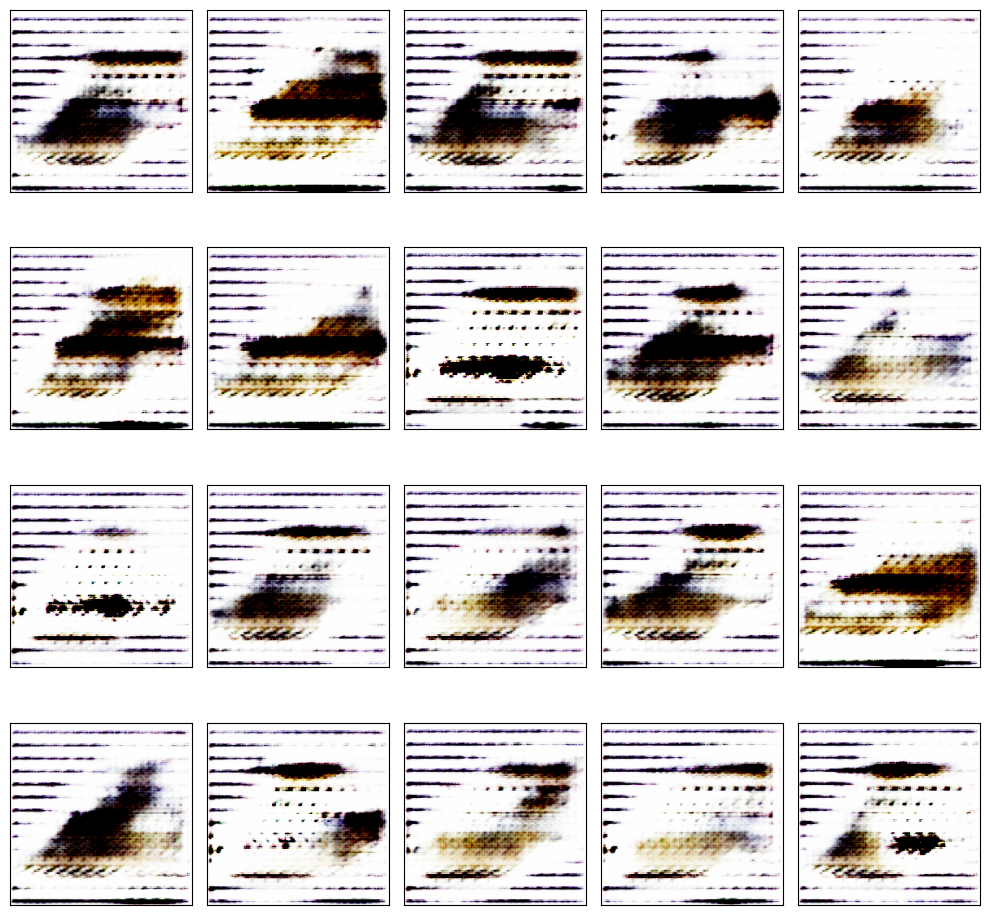

Currently on Epoch 6
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 7
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 8
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 9
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 10
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 13ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

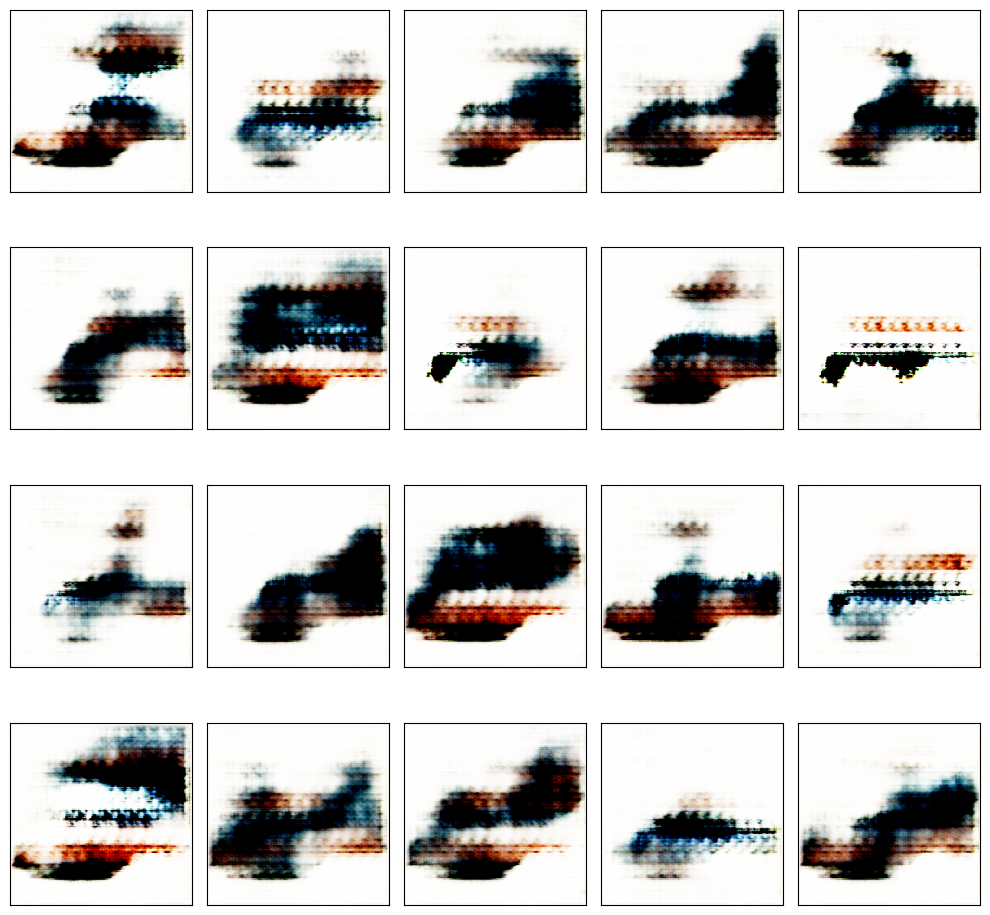

Currently on Epoch 11
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 12
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 13
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 14
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 15
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 12ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

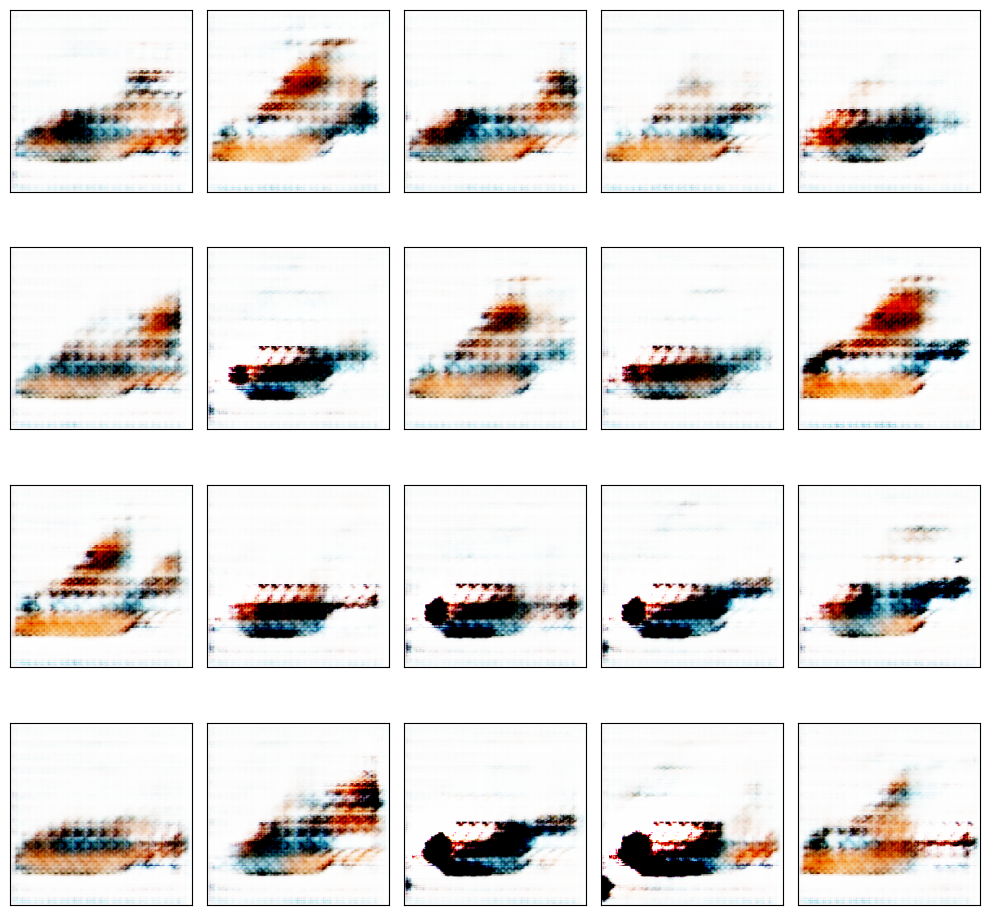

Currently on Epoch 16
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 17
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 18
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 19
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 20
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 12ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

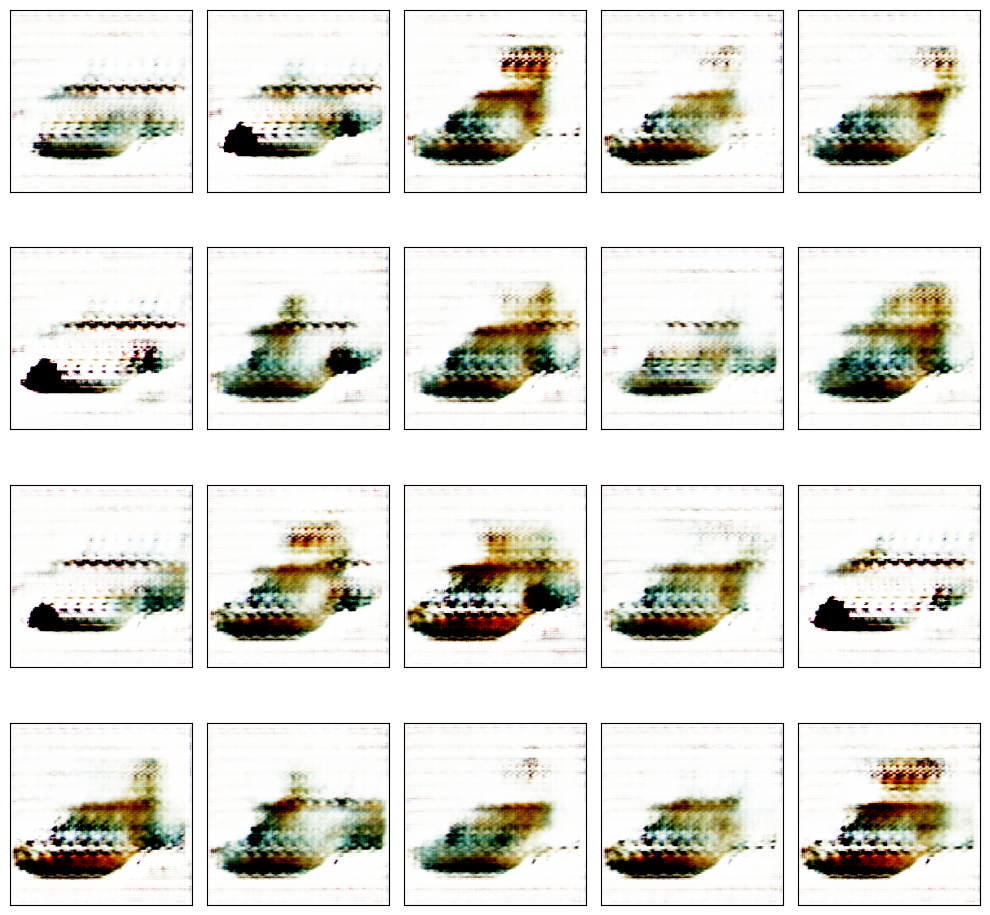

Currently on Epoch 21
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 22
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 23
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 24
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 25
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 13ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

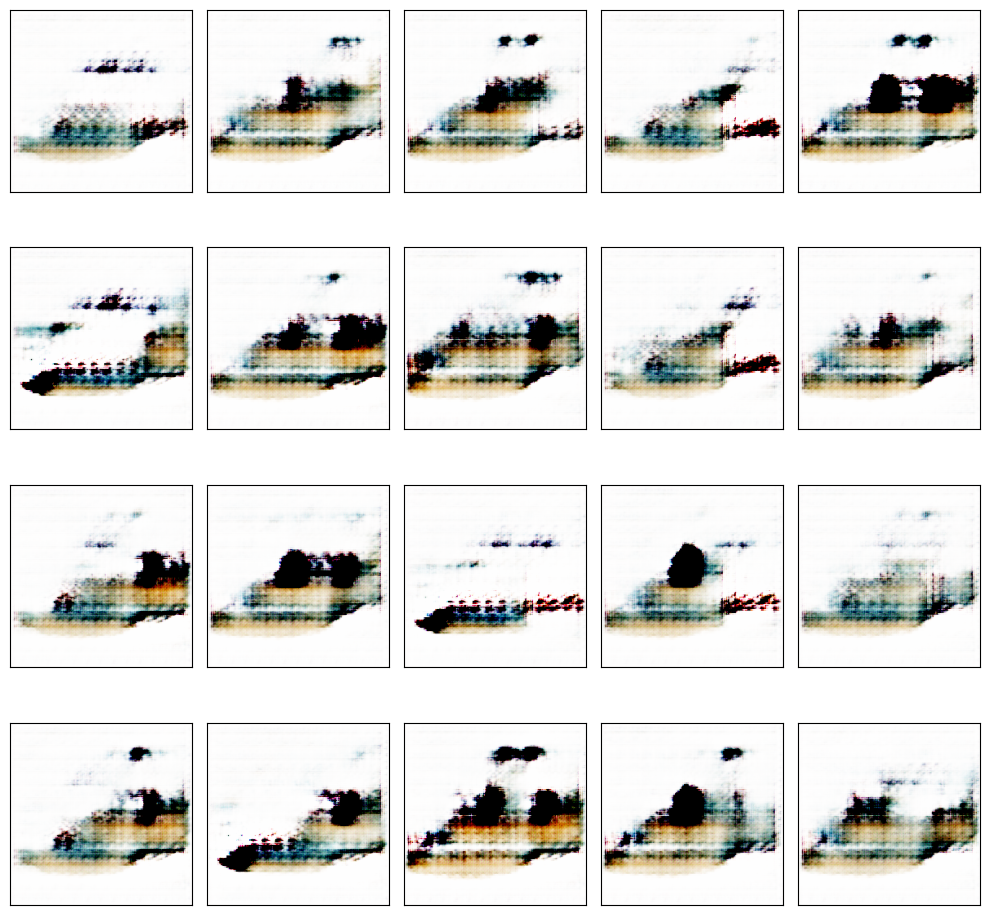

Currently on Epoch 26
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 27
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 28
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 29
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 30
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 17ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

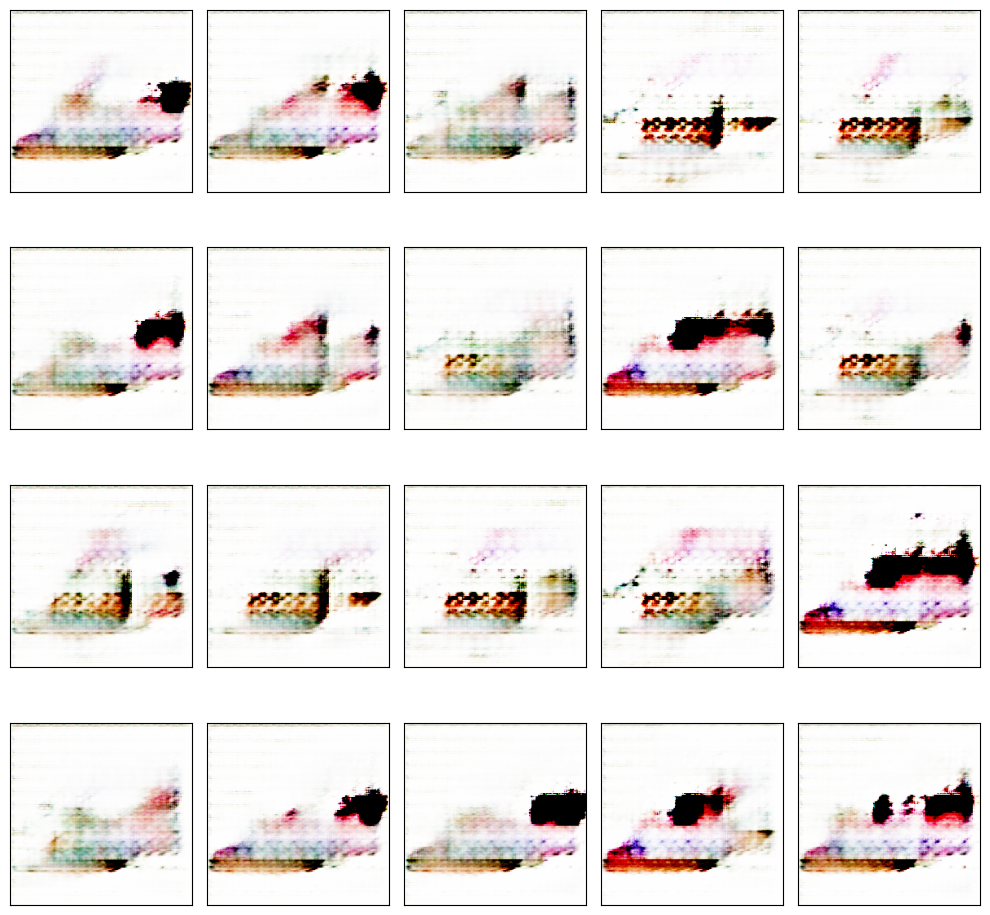

Currently on Epoch 31
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 32
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 33
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 34
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 35
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 13ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

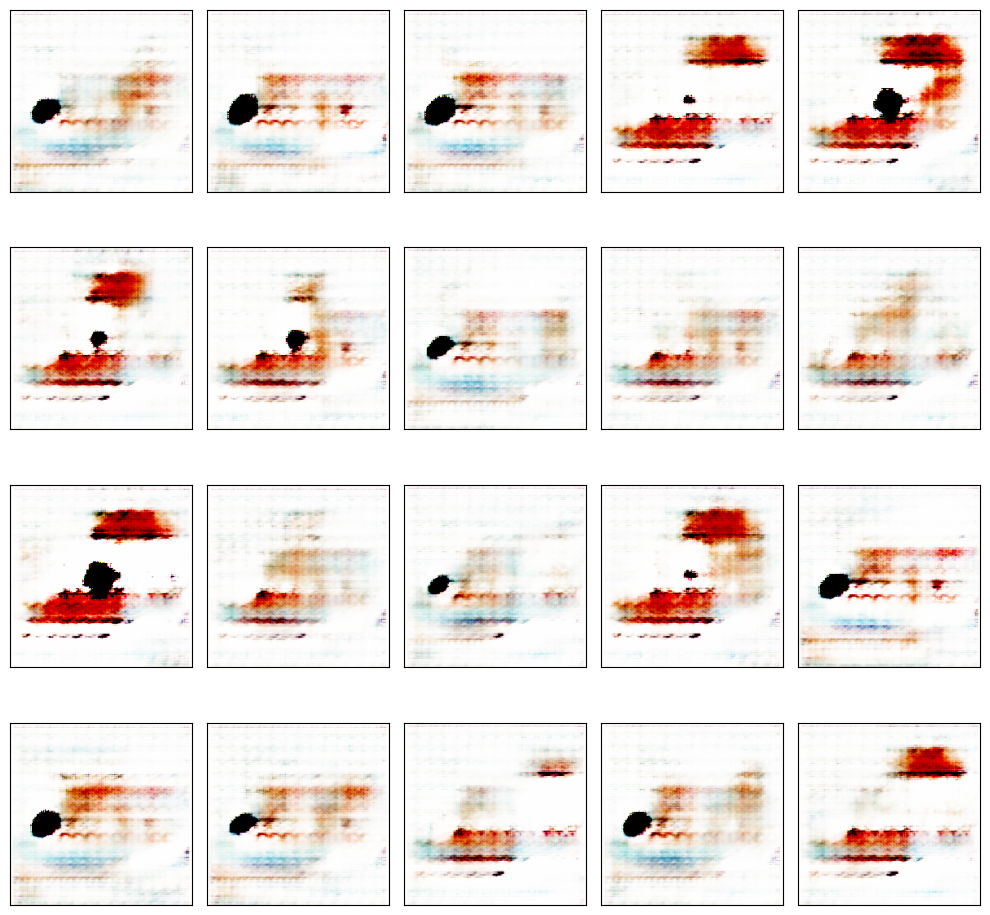

Currently on Epoch 36
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 37
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 38
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 39
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 40
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 12ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

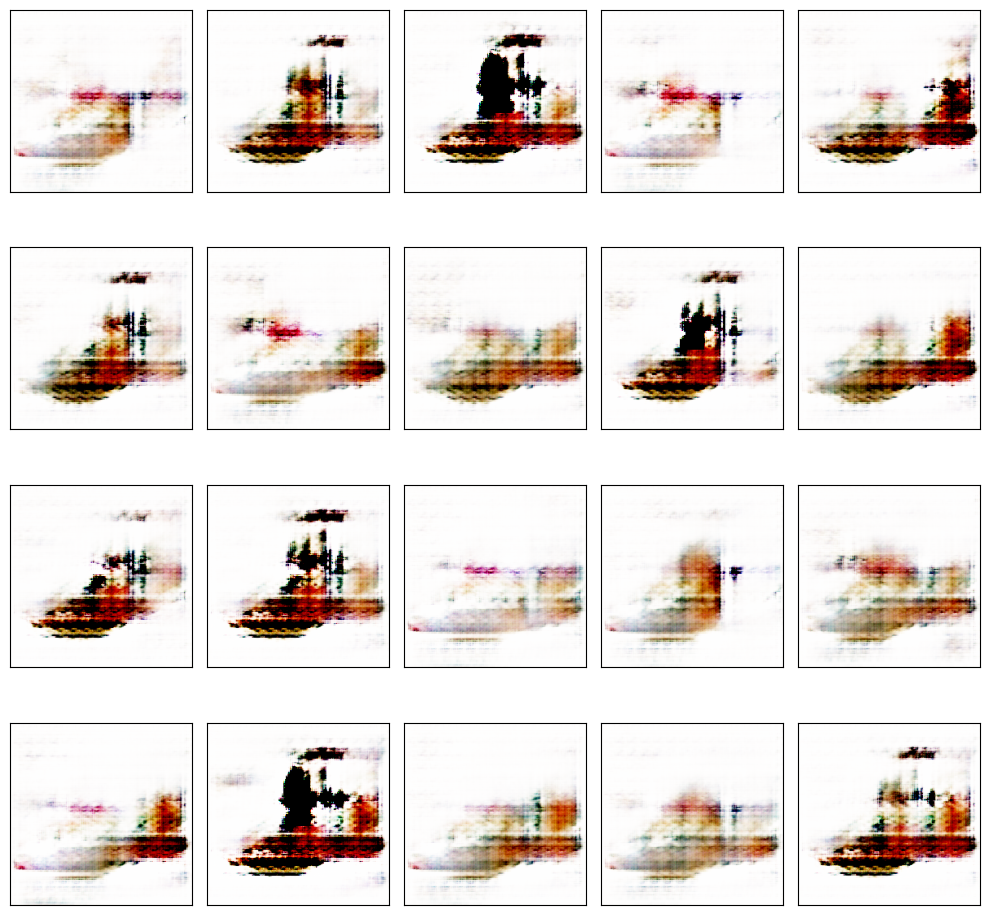

Currently on Epoch 41
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 42
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 43
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 44
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 45
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 14ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

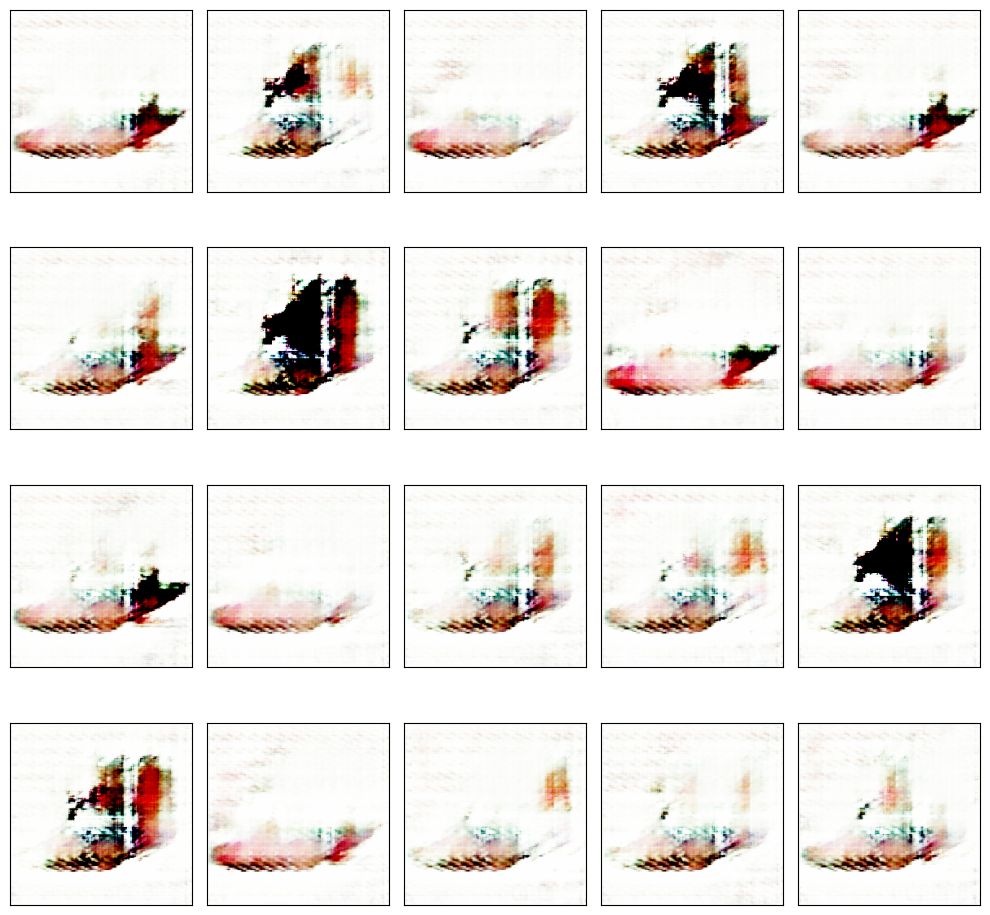

Currently on Epoch 46
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 47
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 48
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 49
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 50
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 13ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

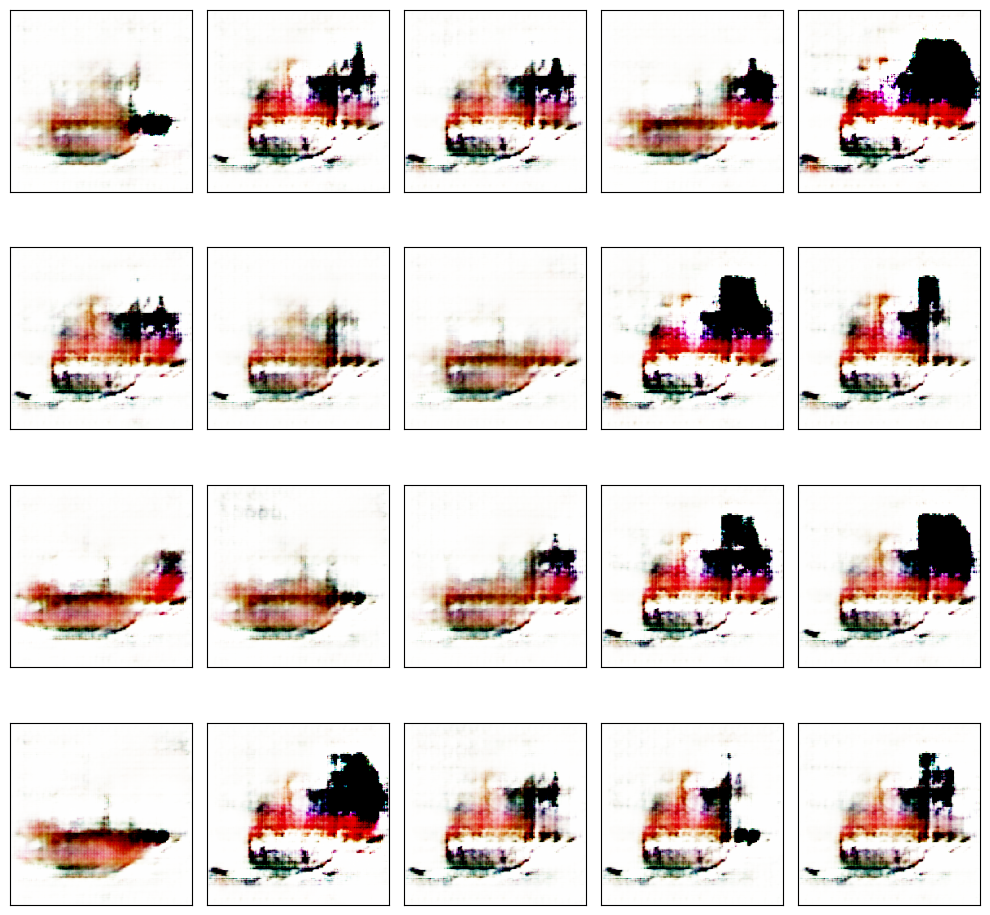

Currently on Epoch 51
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 52
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 53
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 54
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 55
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 15ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

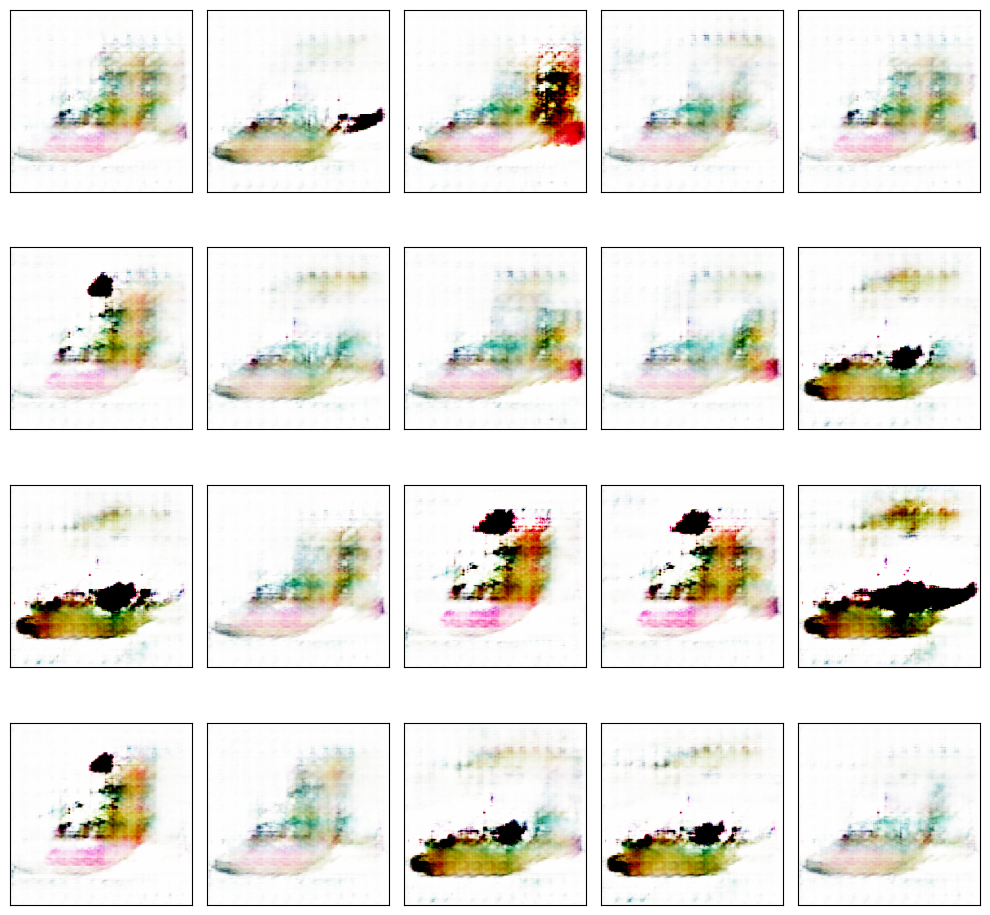

Currently on Epoch 56
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 57
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 58
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 59
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 60
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 14ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

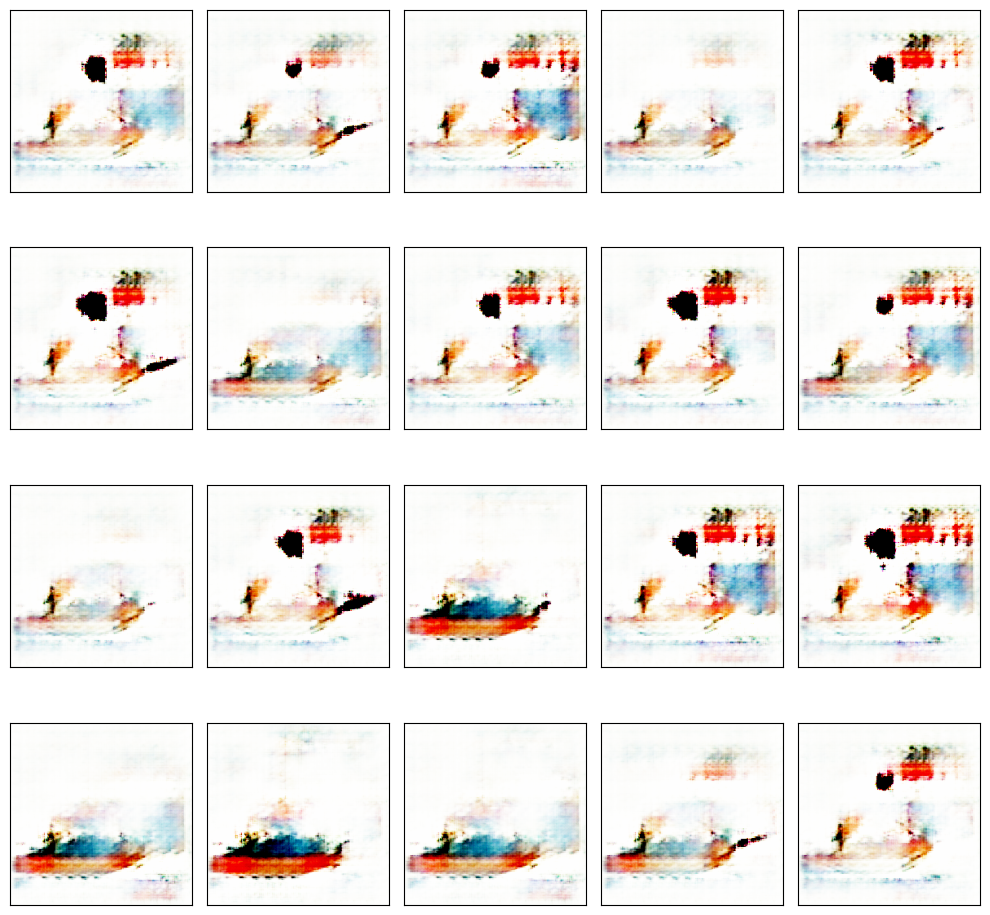

Currently on Epoch 61
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 62
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 63
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 64
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 65
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 13ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

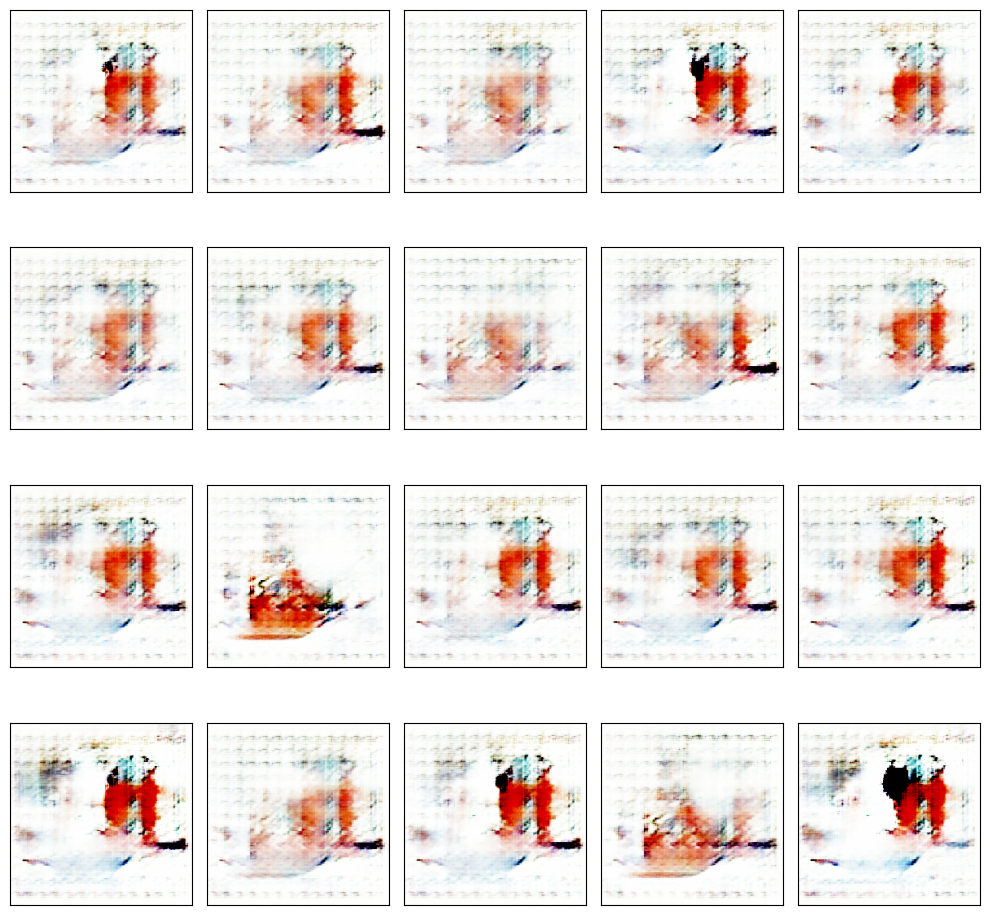

Currently on Epoch 66
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 67
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 68
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 69
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 70
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 12ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

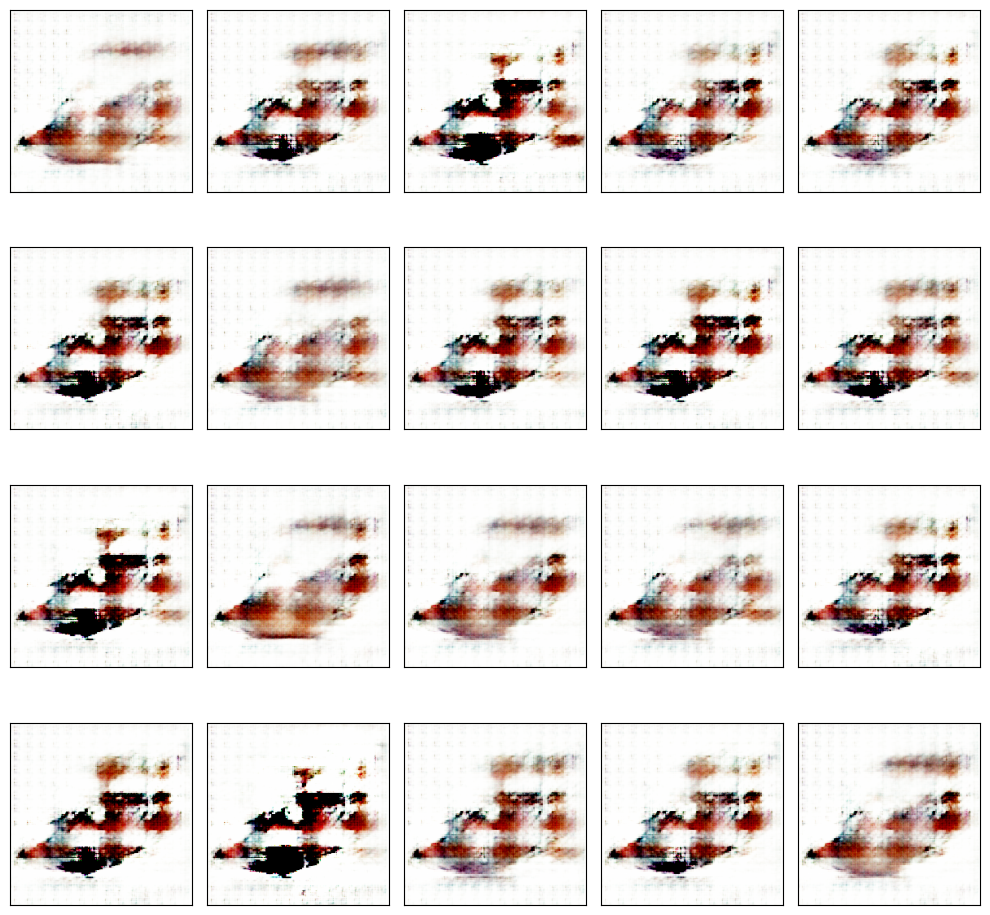

Currently on Epoch 71
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 72
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 73
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 74
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 75
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 12ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

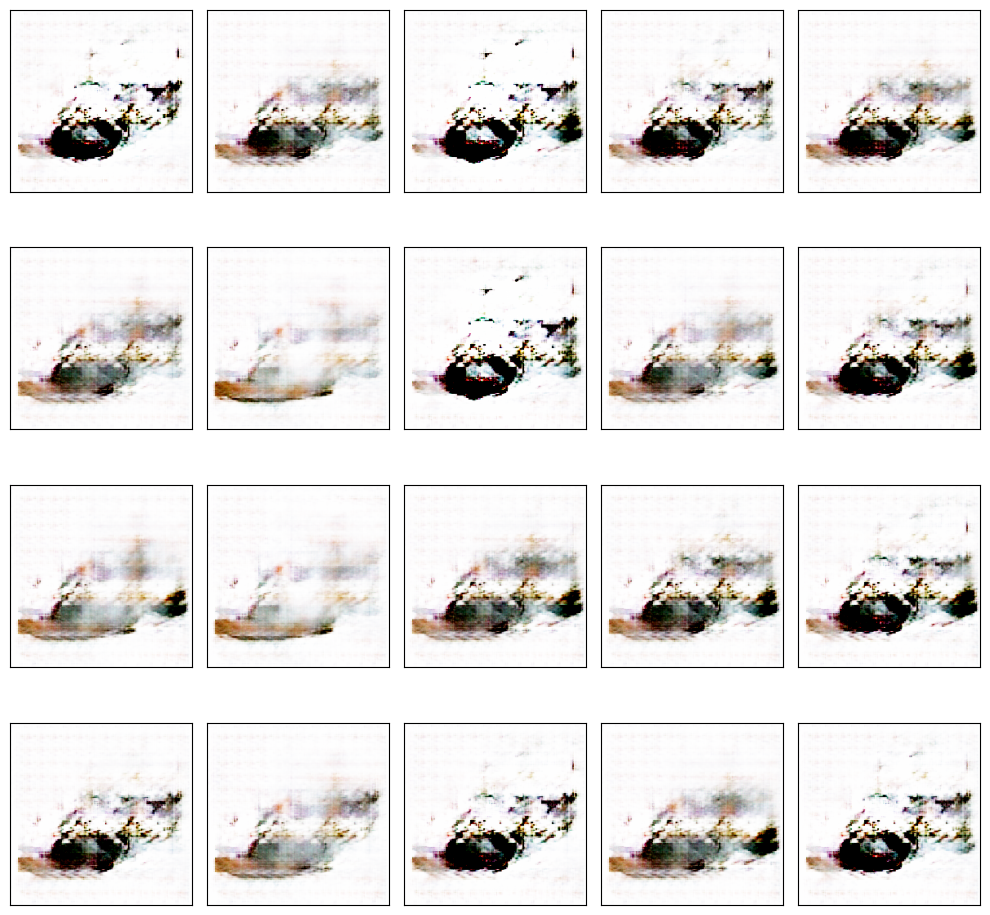

Currently on Epoch 76
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 77
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 78
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 79
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 80
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 12ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

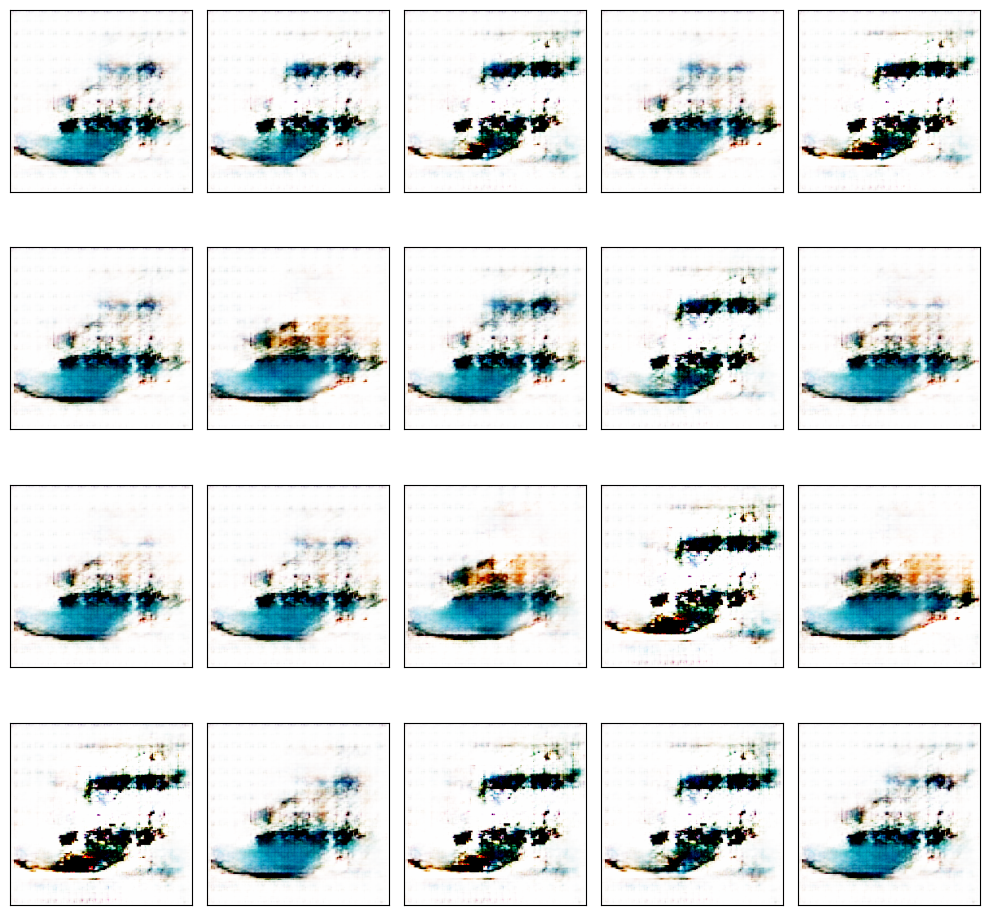

Currently on Epoch 81
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 82
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 83
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 84
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 85
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 12ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

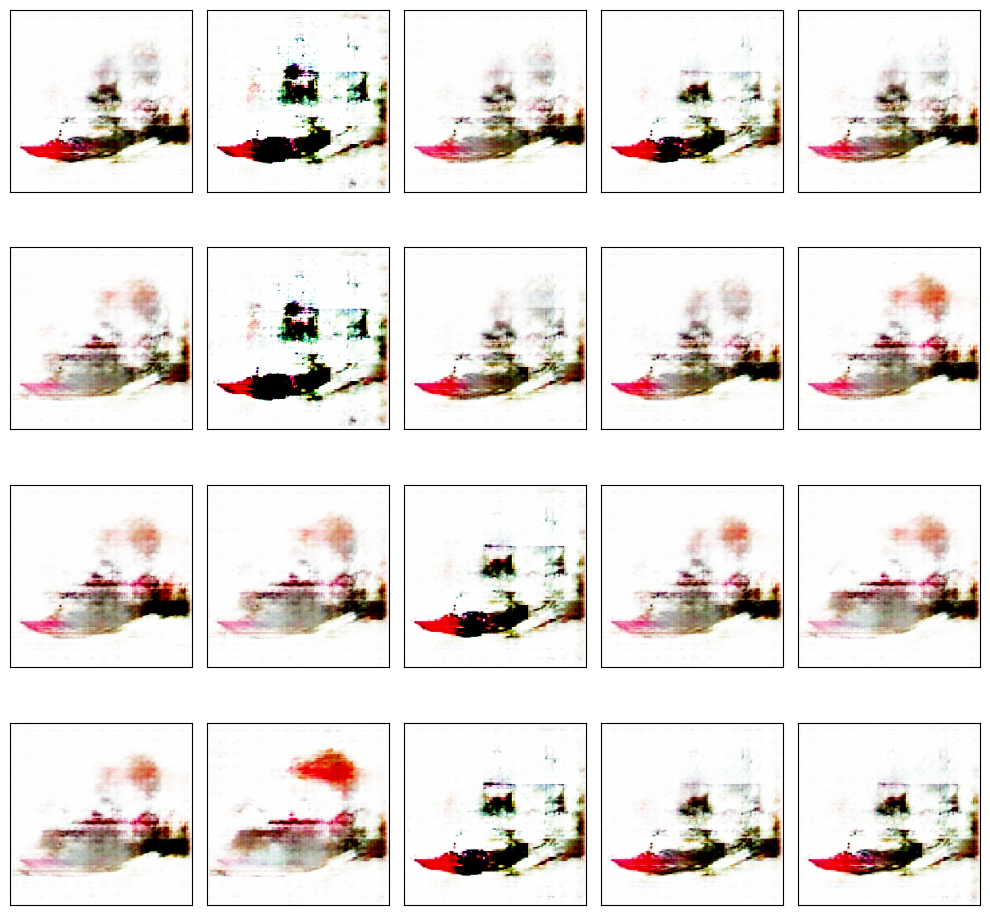

Currently on Epoch 86
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 87
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 88
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 89
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 90
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 13ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

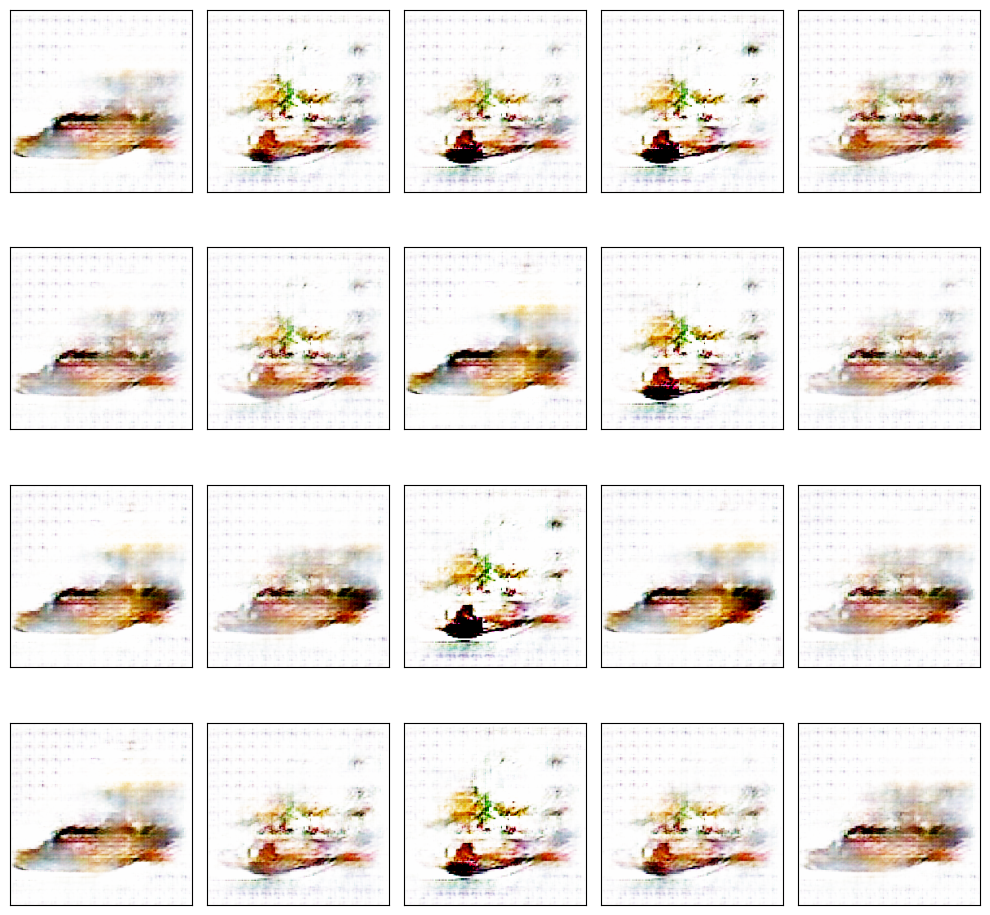

Currently on Epoch 91
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 92
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 93
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 94
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 95
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 12ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

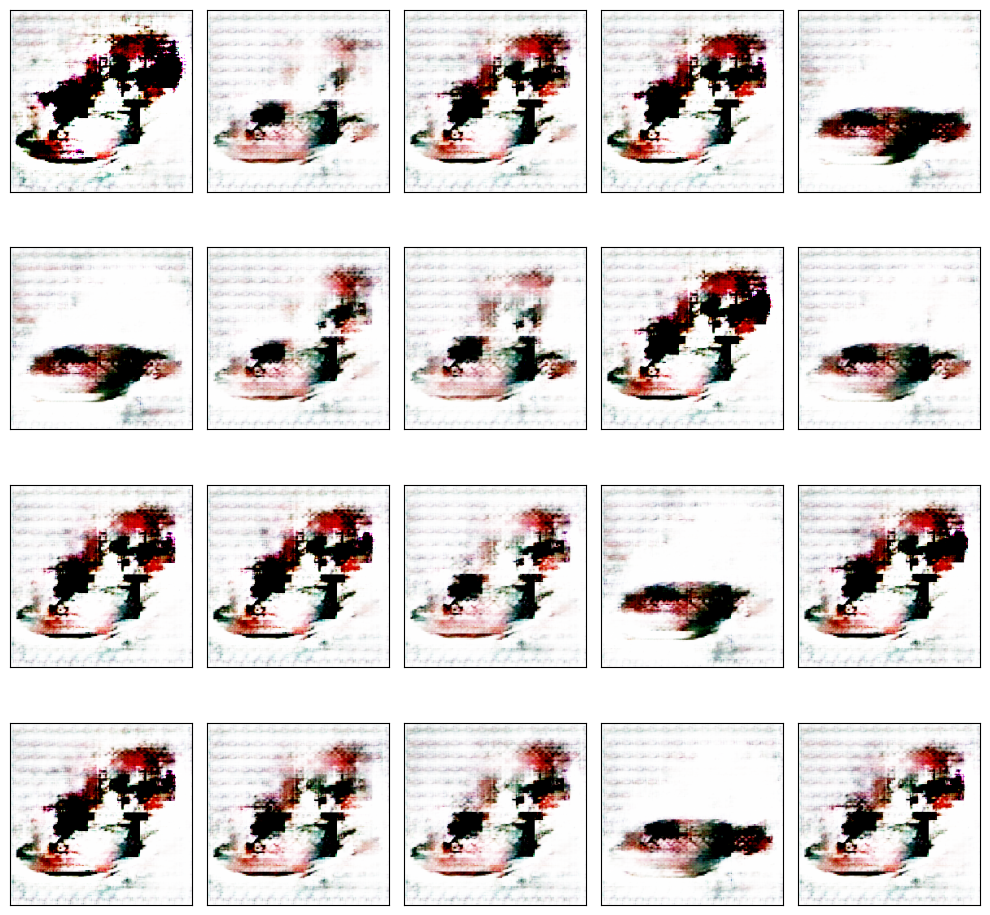

Currently on Epoch 96
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 97
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 98
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 99
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
Currently on Epoch 100
	Currently on batch number 50 of 175
	Currently on batch number 100 of 175
	Currently on batch number 150 of 175
1/1 [==============================] - 0s 15ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

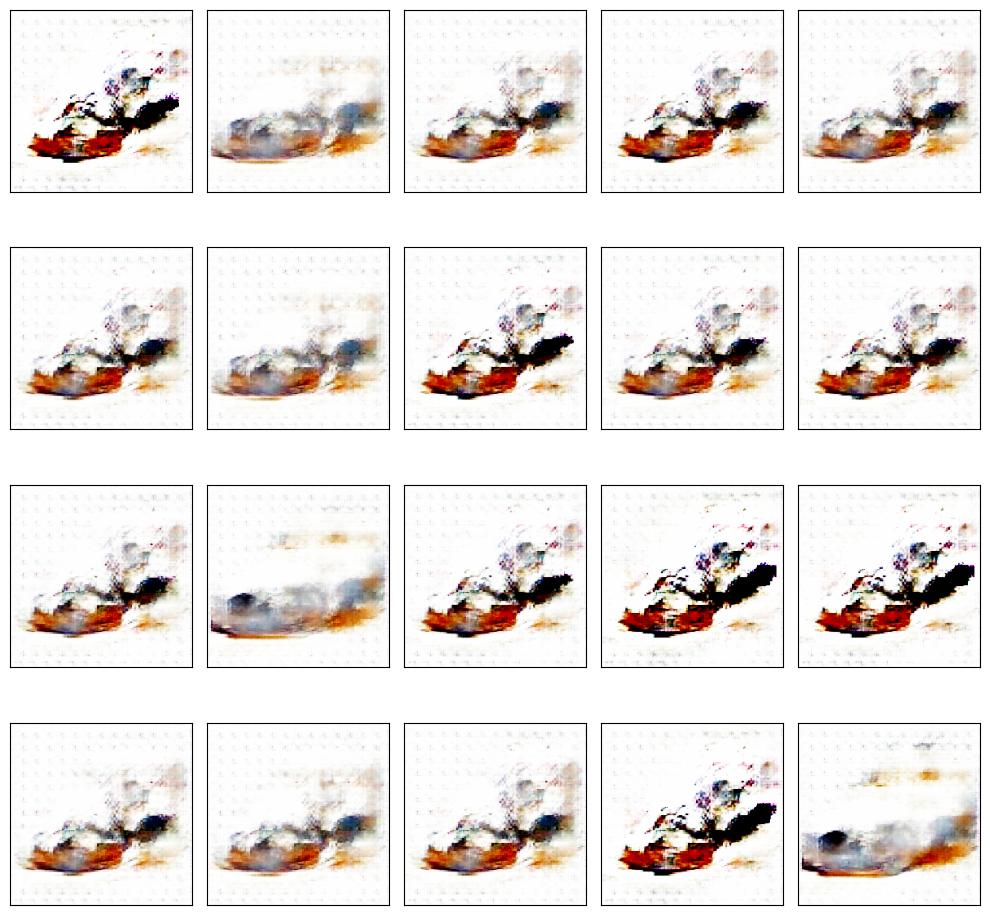

Training is complete


In [119]:
generator_losses = []
discriminator_losses = []
gpu_devices = ['/gpu:0']
for gpu_device in gpu_devices:
    with tf.device(gpu_device):
        for epoch in range(epochs):
            print(f"Currently on Epoch {epoch+1}")

            for i in range(TrainSample_gan.n // batch_size):
                if (i+1) % 50 == 0:
                    print(f"\tCurrently on batch number {i+1} of {TrainSample_gan.n // batch_size}")

                noise = np.random.normal(size=[batch_size, noise_shape])

                gen_image = generator.predict_on_batch(noise)

                train_dataset = next(TrainSample_gan)

                # training discriminator on real images
                train_label = np.ones(shape=(batch_size, 1))
                discriminator.trainable = True
                d_loss_real = discriminator.train_on_batch(train_dataset, train_label)

                # training discriminator on fake images
                train_label = np.zeros(shape=(batch_size, 1))
                d_loss_fake = discriminator.train_on_batch(gen_image, train_label)

                # training generator
                noise = np.random.normal(size=[batch_size, noise_shape])
                train_label = np.ones(shape=(batch_size, 1))
                discriminator.trainable = False
                d_g_loss_batch = gan.train_on_batch(noise, train_label)

                # Append losses to lists
                generator_losses.append(d_g_loss_batch)
                discriminator_losses.append(0.5 * np.add(d_loss_real, d_loss_fake))

     #plotting generated images at the start and then after every 5 epoch
            if (epoch + 1) % 5 == 0:
                samples = 20
                x_fake = generator.predict(np.random.normal(loc=0, scale=1, size=(samples, noise_shape)))

                plt.figure(figsize=(10, 10))
                for k in range(samples):
                    plt.subplot(4, 5, k+1)
                    plt.imshow(x_fake[k].reshape(224, 224, 3))
                    plt.xticks([])
                    plt.yticks([])

                plt.tight_layout()
                plt.show()

print('Training is complete')

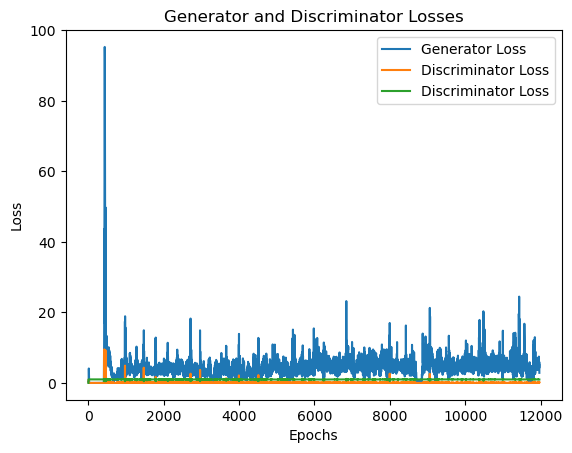

In [97]:
plt.plot(generator_losses, label='Generator Loss')
plt.plot(discriminator_losses, label='Discriminator Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Generator and Discriminator Losses')
plt.legend()
plt.show()